In [2]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score

import scipy.io.wavfile as wavfile
import scipy.fftpack as fftpk
from matplotlib import pyplot as plt

import IPython.display as ipd
import sounddevice as sd
import soundfile as sf
import librosa

import noisereduce as nr

data = pd.read_csv("data/sdcard_failure_classification.csv")
data

,RMS,Mean,MA1,MA2,MA3,F1,F2,F3,FailureID
0,13071.34,7383.30,34,33,33,1875.00,1210.94,1617.19,1
1,13166.77,7690.08,34,32,31,703.12,1890.62,1265.63,1
2,13078.75,7509.58,47,42,42,703.12,39.06,1601.56,1
3,13115.34,7509.37,35,35,34,695.31,1867.19,1484.37,1
4,13180.50,7616.29,49,49,45,703.12,1289.06,1367.19,1
...,...,...,...,...,...,...,...,...,...
904,12825.85,7479.29,60,44,43,1601.56,1078.13,1328.13,4
905,12806.98,7534.00,48,31,30,1601.56,578.12,492.19,4
906,13054.90,7638.73,55,39,38,1601.56,1492.19,62.50,4
907,12987.58,7529.69,53,39,37,1601.56,1015.63,757.81,4


In [269]:
predictors= ["RMS","Mean","MA1","MA2","MA3","F1","F2","F3"]
target= "FailureID"

In [270]:
def test_predict(train,test,predictors,target):
    rf = RandomForestClassifier(min_samples_split=10,random_state=1)
    rf.fit(train[predictors],train[target])
    preds = rf.predict(test)
    return preds


tr =[]
te =[]
all_preds=[]
for i in range(data.shape[0]-1):
    if i%5 != 0 :
        tr.append(i)
    else:
        te.append(i)
train = data.iloc[tr]
test = data.iloc[te][predictors]
all_preds.append(test_predict(train,test,predictors,target))
preds = np.concatenate(all_preds)
accuracy = accuracy_score(data.iloc[te][target],preds)
   

In [271]:
preds      

array([3, 1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 4, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 3, 3, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4], dtype=int64)

In [272]:
accuracy

0.967032967032967

In [273]:
input = np.array([[13754.90,7638.73,55,39,38,1601.56,1492.19,193]])
input_test = pd.DataFrame(input)
input_test.columns = ["RMS","Mean","MA1","MA2","MA3","F1","F2","F3"]
input_test

,RMS,Mean,MA1,MA2,MA3,F1,F2,F3
0,13754.9,7638.73,55.0,39.0,38.0,1601.56,1492.19,193.0


In [274]:
new_preds = test_predict(train,input_test,predictors,target)
if new_preds==[1]:
    print("Off condition with noice")
elif new_preds==[2]:
    print("Healthy condition")
elif new_preds==[3]:
    print("Bearing Fault")
else:
    print("Fan Fault")

Fan Fault


In [275]:
samplerate = 48000  
duration = 30 # seconds
filename = 'test.wav'
print("start")
mydata = sd.rec(int(samplerate * duration), samplerate=samplerate,
    channels=1, blocking=True)
print("end")
sd.wait()
sf.write(filename, mydata, samplerate)


start
end


In [276]:
samples,samplerate = librosa.load("M1_OFF_S1.wav",sr = 48000)
ipd.Audio(samples,rate =48000)

In [277]:
samples,samplerate = librosa.load("M1_H_S1.wav",sr = 48000)
ipd.Audio(samples,rate =48000)

In [278]:
samples,samplerate = librosa.load("M1_F1_S1.wav",sr = 48000)
ipd.Audio(samples,rate =48000)

In [13]:
samples,samplerate = librosa.load("test.wav",sr = 48000)
ipd.Audio(samples,rate =48000)

In [12]:
data, samplerate = sf.read('test.wav')
# reduce noise
y_reduced_noise = nr.reduce_noise(y=data, sr=samplerate)
# save audio
sf.write('reduced.wav', y_reduced_noise, samplerate, subtype="PCM_24")
# load and play audio
data, samplerate = librosa.load('reduced.wav')
ipd.Audio('reduced.wav')

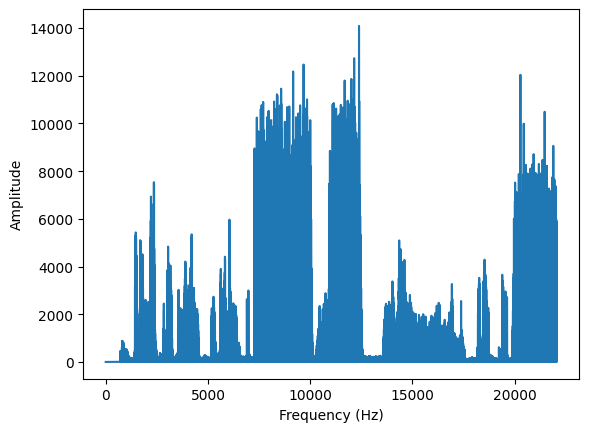

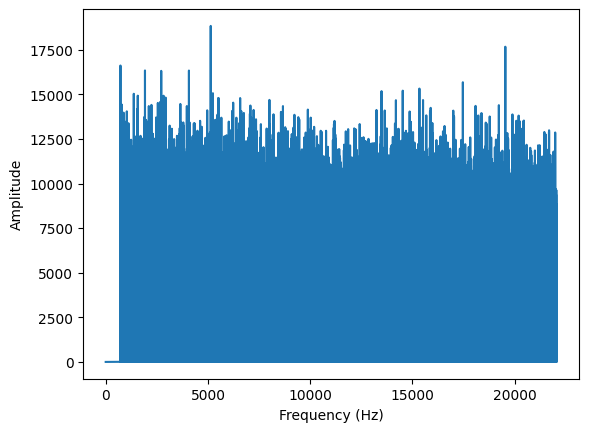

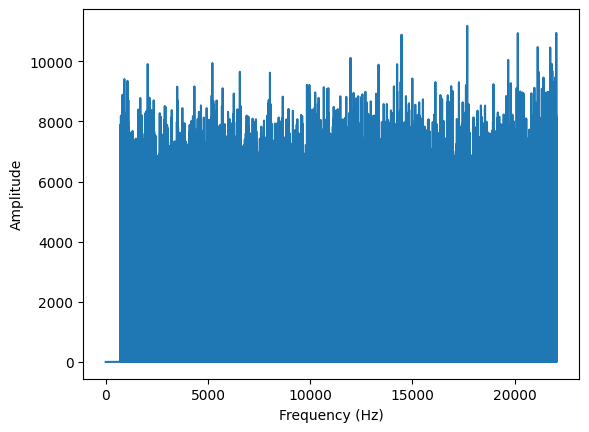

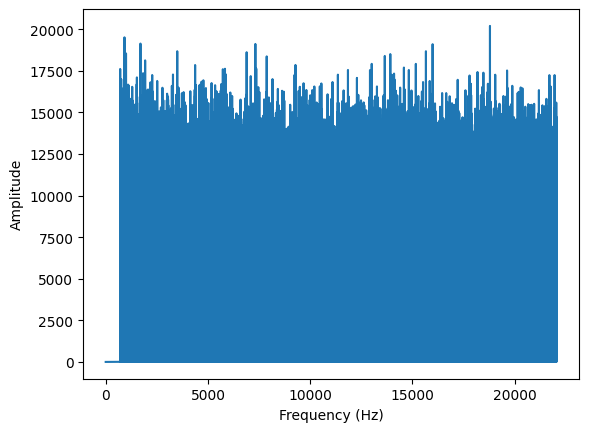

In [328]:
s_rate, signal1 = wavfile.read("M1_OFF_S1.wav")

FFT1 = abs(fftpk.fft(signal1))
freqs1 = fftpk.fftfreq(len(FFT1), 1.0/s_rate)

plt.plot(freqs1[range(len(FFT1)//2)], FFT1[range(len(FFT1)//2)][:,0])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

s_rate, signal2 = wavfile.read("M1_H_S1.wav")

FFT2 = abs(fftpk.fft(signal2))
freqs2 = fftpk.fftfreq(len(FFT2), 1.0/s_rate)

plt.plot(freqs2[range(len(FFT2)//2)], FFT2[range(len(FFT2)//2)][:,0])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

s_rate, signal3 = wavfile.read("M1_F1_S1.wav")

FFT3 = abs(fftpk.fft(signal3))
freqs3 = fftpk.fftfreq(len(FFT3), 1.0/s_rate)

plt.plot(freqs3[range(len(FFT3)//2)], FFT3[range(len(FFT3)//2)][:,0])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

s_rate, signal4 = wavfile.read("M1_F2_S1.wav")

FFT4 = abs(fftpk.fft(signal4))
freqs4 = fftpk.fftfreq(len(FFT4), 1.0/s_rate)

plt.plot(freqs4[range(len(FFT4)//2)], FFT4[range(len(FFT4)//2)][:,0])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

In [447]:
data[data["FailureID"]==2]

,RMS,Mean,MA1,MA2,MA3,F1,F2,F3,FailureID
248,12817.18,7524.02,57,46,45,1000.00,1156.25,1171.88,2
249,12779.57,7509.68,46,31,31,1000.00,1734.37,1976.56,2
250,13072.49,7568.02,51,40,39,1000.00,1367.19,1890.62,2
251,13166.80,7729.83,53,40,38,1000.00,1695.31,1335.94,2
252,12843.12,7594.63,51,38,38,1000.00,1125.00,1578.12,2
...,...,...,...,...,...,...,...,...,...
455,13263.93,7705.50,44,36,34,1000.00,1906.25,687.50,2
456,13396.94,7762.47,41,39,38,1718.75,1812.50,54.69,2
457,13071.47,7633.73,34,34,33,1476.56,1523.44,1750.00,2
458,13315.19,7781.66,49,49,49,1218.75,1765.62,1953.12,2


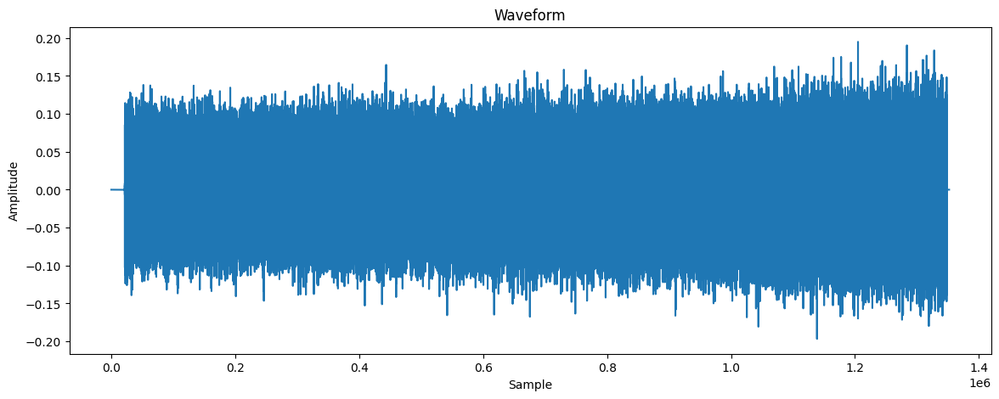

In [444]:
import matplotlib.pyplot as plt
import librosa

# Replace 'your_audio_file.wav' with the path to your audio file
audio_file = 'M1_F1_S1.wav'

# Load the audio file
samples, samplerate = librosa.load(audio_file)

# Plot the waveplot using matplotlib
plt.figure(figsize=(14, 5))
plt.plot(samples)
plt.title('Waveform')
plt.xlabel('Sample')
plt.ylabel('Amplitude')
plt.show()

In [445]:
y= abs(samples).max()
y

0.1968207

In [11]:
samplerate = 48000  
duration = 15 # seconds
audio = 'test.wav'
print("start")
mydata = sd.rec(int(samplerate * duration), samplerate=samplerate,
    channels=1, blocking=True)
print("end")
sd.wait()
sf.write(audio, mydata, samplerate)

start
end


In [533]:
def extract_features(audio):
    
    s_rate, signal = wavfile.read(audio)
    
    mean = abs(signal).mean()

    rms = np.sqrt((signal**2).mean())
    
    FFT_ = abs(fftpk.fft(signal))
    FFT = FFT_[range(len(FFT_)//2)]
    freqs = fftpk.fftfreq(len(FFT), 1.0/s_rate)[range(len(FFT_)//2)]
    
    sorted = np.sort(FFT)[::-1]
    ma1, ma2 , ma3 = sorted[[0,1,2]]
    
    max_amp_index = [np.where(FFT == sorted[0])[0], np.where(FFT == sorted[1])[0], np.where(FFT == sorted[2])[0]]
    f1, f2, f3 = np.concatenate(freqs1[max_amp_index])
    
    features = [rms,mean,ma1,ma2,ma3,f1,f2,f3]
    return features


input= extract_features(audio) 
input_test = pd.DataFrame([input])
input_test.columns = ["RMS","Mean","MA1","MA2","MA3","F1","F2","F3"]
input

[48.20770948890505,
 65.59820972222222,
 1982565.060495968,
 1978251.9556678822,
 1974166.324515837,
 465.2742496072748,
 478.07308220851917,
 478.08938645387104]

In [530]:
new_preds = test_predict(train,input_test,predictors,target)
if new_preds==[1]:
    print("Off condition with noice")
elif new_preds==[2]:
    print("Healthy condition")
elif new_preds==[3]:
    print("Bearing Fault")
else:
    print("Fan Fault")

Off condition with noice


In [1]:
%pip install noisereduce


[notice] A new release of pip is available: 23.1.1 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip
